In [1]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
def dx_dt(t, x, y, z, sigma, b, r):
    return sigma * (y - x)

def dy_dt(t, x, y, z, sigma, b, r):
    # на фотке "x * (r - z) + y"
    return x * (r - z) - y

def dz_dt(t, x, y, z, sigma, b, r):
    # на фотке "- x * y - b * z"
    return x * y - b * z

In [4]:
sigma = 10
b = 8 / 3
rs = [0.5, 10, 24.06, 30]
dt = 0.001
max_t = 20

In [5]:
def euler(r, t0=0, x0=13.41265629, y0=13.46430003, z0=33.46156416):
    t = t0
    x = x0
    y = y0
    z = z0
    
    ts = [t0]
    xs = [x0]
    ys = [y0]
    zs = [z0]
    
    while t < max_t:
        
        x_i = dx_dt(t, x, y, z, sigma, b, r) * dt
        y_i = dy_dt(t, x, y, z, sigma, b, r) * dt
        z_i = dz_dt(t, x, y, z, sigma, b, r) * dt
        t += dt
        x += x_i
        y += y_i
        z += z_i
        
        ts.append(t)
        xs.append(x)
        ys.append(y)
        zs.append(z)
    
    return ts, xs, ys, zs

In [6]:
def RK4(r, t0=0, x0=13.41265629, y0=13.46430003, z0=33.46156416):
    t = t0
    x = x0
    y = y0
    z = z0
    
    ts = [t0]
    xs = [x0]
    ys = [y0]
    zs = [z0]
    
    while t < max_t:       
        k1 = dx_dt(t           , x                , y, z, sigma, b, r)
        k2 = dx_dt(t + 0.5 * dt, x + 0.5 * dt * k1, y, z, sigma, b, r)
        k3 = dx_dt(t + 0.5 * dt, x + 0.5 * dt * k2, y, z, sigma, b, r)
        k4 = dx_dt(t + dt      , x + dt * k3      , y, z, sigma, b, r)
        x_i = dt * (k1 + 2 * k2 + 2 * k3 + k4) / 6 
        
        k1 = dy_dt(t           , x, y                , z, sigma, b, r)
        k2 = dy_dt(t + 0.5 * dt, x, y + 0.5 * dt * k1, z, sigma, b, r)
        k3 = dy_dt(t + 0.5 * dt, x, y + 0.5 * dt * k2, z, sigma, b, r)
        k4 = dy_dt(t + dt      , x, y + dt * k3      , z, sigma, b, r)
        y_i = dt * (k1 + 2 * k2 + 2 * k3 + k4) / 6
        
        k1 = dz_dt(t           , x, y, z                , sigma, b, r)
        k2 = dz_dt(t + 0.5 * dt, x, y, z + 0.5 * dt * k1, sigma, b, r)
        k3 = dz_dt(t + 0.5 * dt, x, y, z + 0.5 * dt * k2, sigma, b, r)
        k4 = dz_dt(t + dt      , x, y, z + dt * k3      , sigma, b, r)
        z_i = dt * (k1 + 2 * k2 + 2 * k3 + k4) / 6 
        
        t += dt
        x += x_i
        y += y_i
        z += z_i
        
        ts.append(t)
        xs.append(x)
        ys.append(y)
        zs.append(z)
    
    return ts, xs, ys, zs

In [7]:
def draw():
    for r in rs:
        ts0, xs0, ys0, zs0 = euler(r)
        ts1, xs1, ys1, zs1 = RK4(r)

        print('r = {0}'.format(r))
        plt.plot(ts0, xs0, label='euler')
        plt.plot(ts1, xs1, label='RK4')
        plt.xlabel('t')
        plt.ylabel('x')
        plt.legend(loc=(1.04,0))
        plt.show()
        
        plt.plot(ts0, ys0, label='euler')
        plt.plot(ts1, ys1, label='RK4')
        plt.xlabel('t')
        plt.ylabel('y')
        plt.legend(loc=(1.04,0))
        plt.show()
        
        plt.plot(ts0, zs0, label='euler')
        plt.plot(ts1, zs1, label='RK4')
        plt.xlabel('t')
        plt.ylabel('z')
        plt.legend(loc=(1.04,0))
        plt.show()
        
        fig = go.Figure(
            data=[
                go.Scatter3d(
                    x=xs0,
                    y=ys0,
                    z=zs0,
                    marker=go.Marker(
                        size=1
                    )
                )
            ]
        )
        fig.show()
        
        fig = go.Figure(
            data=[
                go.Scatter3d(
                    x=xs1,
                    y=ys1,
                    z=zs1,
                    marker=go.Marker(
                        size=1
                    )
                )
            ]
        )
        fig.show()

r = 0.5


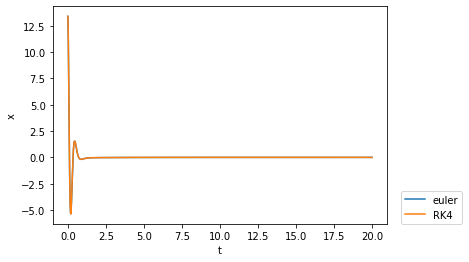

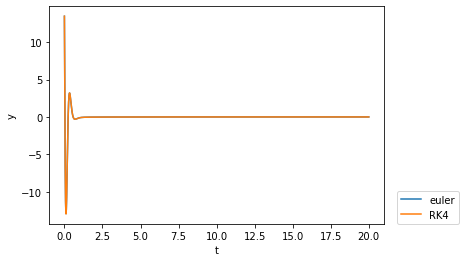

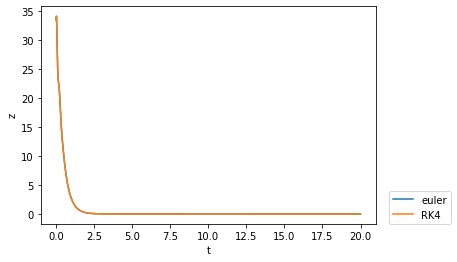

r = 10


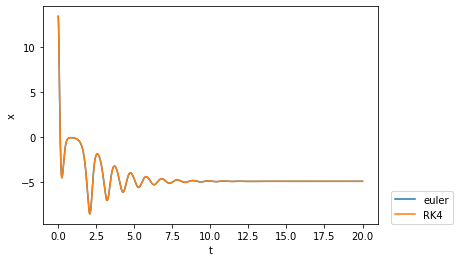

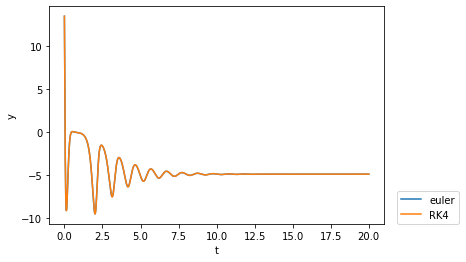

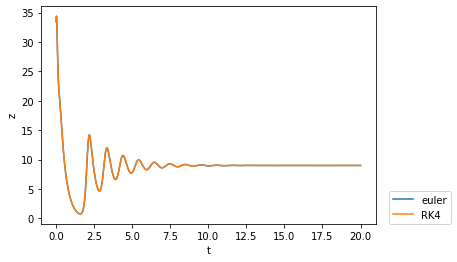

r = 24.06


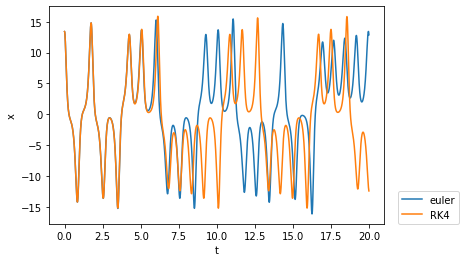

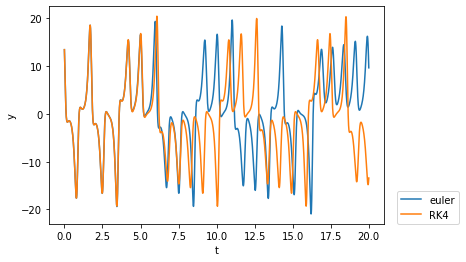

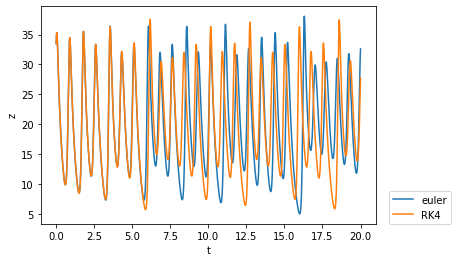

r = 30


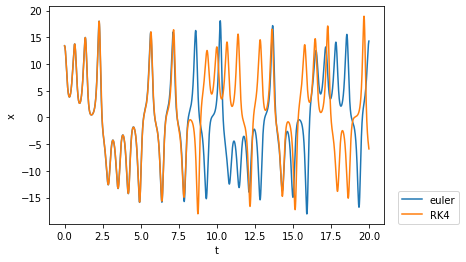

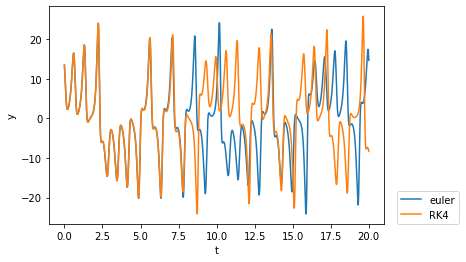

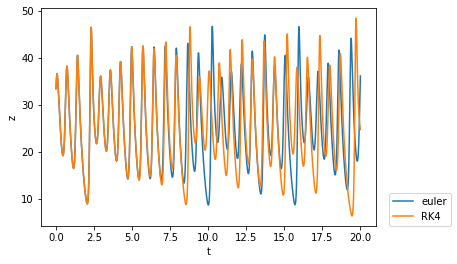

In [8]:
draw()